## Lượng mưa thay đổi theo mùa, theo khu vực và theo thời gian trong ngày như thế nào?

In [100]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
headers = ["datetime", "temperature", "humidity", 
           "precipitation", "windspeed", "winddirection", 
           "cloudcover", "pressure", "dewpoint",
          "month", "hour", "season", "day_night",
          "location_id"]
climate_df = pd.read_csv("../data/processed/hcm_weather_processed.csv", header=0, names=headers)
climate_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128448 entries, 0 to 128447
Data columns (total 14 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   datetime       128448 non-null  object 
 1   temperature    128448 non-null  float64
 2   humidity       128448 non-null  int64  
 3   precipitation  128448 non-null  float64
 4   windspeed      128448 non-null  float64
 5   winddirection  128448 non-null  int64  
 6   cloudcover     128448 non-null  int64  
 7   pressure       128448 non-null  float64
 8   dewpoint       128448 non-null  float64
 9   month          128448 non-null  int64  
 10  hour           128448 non-null  int64  
 11  season         128448 non-null  object 
 12  day_night      128448 non-null  object 
 13  location_id    128448 non-null  int64  
dtypes: float64(5), int64(6), object(3)
memory usage: 13.7+ MB


In [3]:
rain_df = climate_df[climate_df["precipitation"] > 0]

#### Từng yếu tố

**Khu vực**

/tmp/ipykernel_162510/19933655.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=climate_df, x="location_id", y="precipitation",


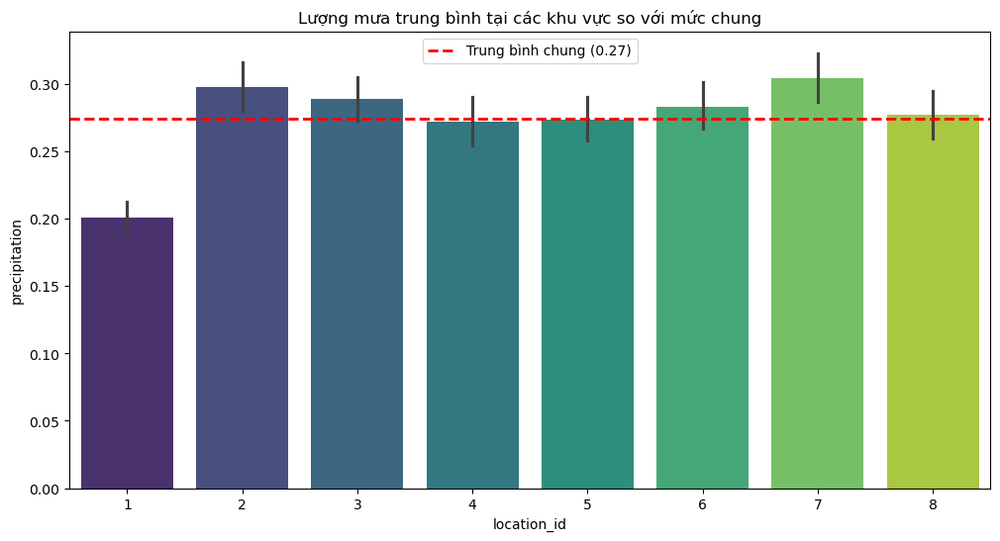

In [6]:
# 1. Tính giá trị trung bình chung của toàn bộ dữ liệu
global_mean = climate_df["precipitation"].mean()

plt.figure(figsize=(12, 6))

# 2. Vẽ biểu đồ cột
sns.barplot(data=climate_df, x="location_id", y="precipitation", 
            estimator='mean', errorbar=('ci', 95), palette="viridis")

# 3. Đường trung bình
plt.axhline(y=global_mean, color='red', linestyle='--', linewidth=2, label=f'Trung bình chung ({global_mean:.2f})')

# 4. Legend
plt.legend()

plt.title("Lượng mưa trung bình tại các khu vực so với mức chung")
plt.show()

Nhận xét:
- Ngoại trừ khu vực đầu tiên có lượng mưa trung bình thấp hơn đáng kể. Các khu vực còn lại có sự khác biệt không quá lớn.

**Thời điểm trong ngày**

Vì dữ liệu phân bố theo hourly, ta xét cả dataset `climate_df` (tất cả giờ).

In [7]:
climate_df['hour'] = pd.to_datetime(climate_df['datetime']).dt.hour

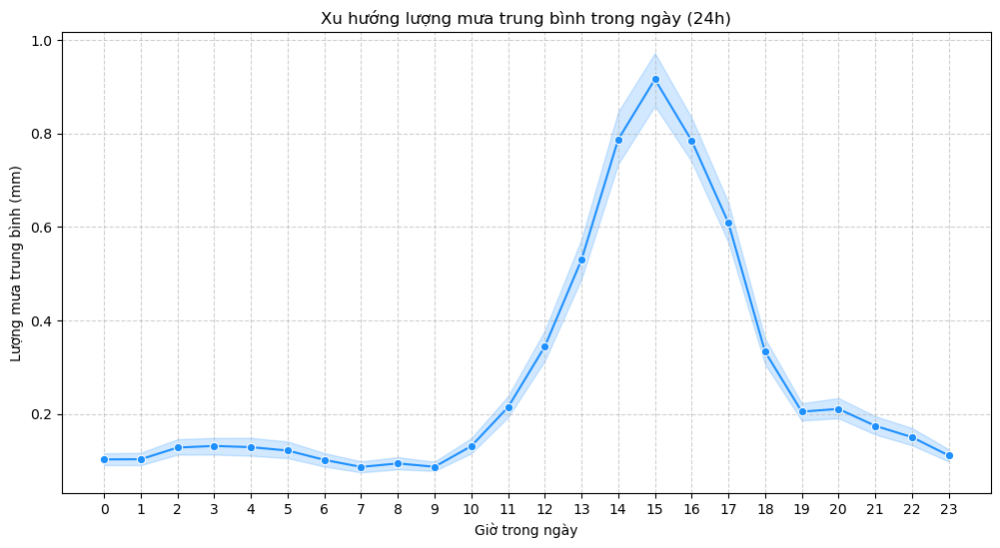

In [8]:
plt.figure(figsize=(12, 6))

sns.lineplot(data=climate_df, x="hour", y="precipitation", 
             estimator='mean', errorbar=('ci', 95), marker="o", color="dodgerblue")

plt.title("Xu hướng lượng mưa trung bình trong ngày (24h)")
plt.xlabel("Giờ trong ngày")
plt.ylabel("Lượng mưa trung bình (mm)")
plt.xticks(range(0, 24))
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

Nhận xét:
- Lượng mưa được phân bố không đều, sáng (0-8 giờ) thường rất ít, trong khi chiều (14-17 giờ) thường có lượng mưa lớn nhất trong ngày.

> Nhìn chung, các địa điểm được xét có đại đa số thời gian là rất ít mưa.

**Quy luật về thời điểm mưa trong ngày có thay đổi theo mùa không ?**

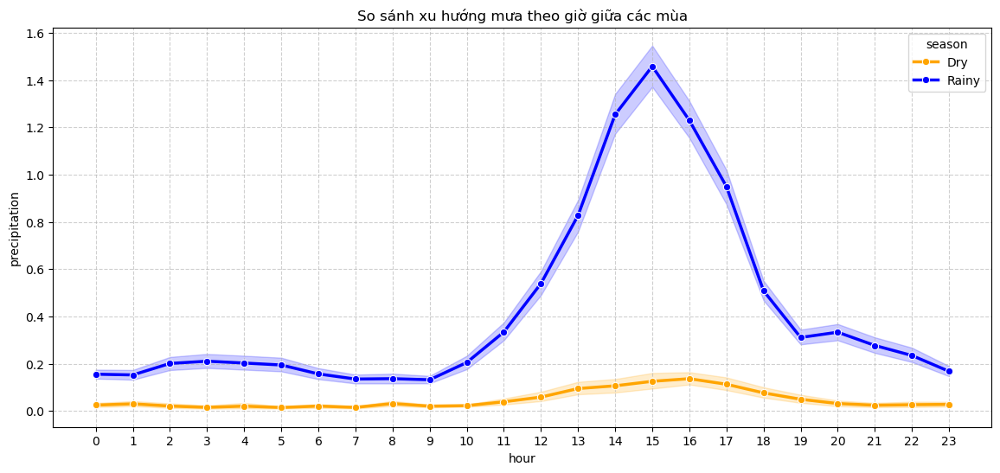

In [9]:
plt.figure(figsize=(14, 6))

sns.lineplot(
    data=climate_df, 
    x='hour', 
    y='precipitation',
    hue='season',
    palette=['orange', 'blue'],
    marker='o',
    linewidth=2.5,
    errorbar=('ci', 95)
)

plt.title("So sánh xu hướng mưa theo giờ giữa các mùa")
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(range(0, 24)) # Hiển thị đủ trục 24h
plt.show()

Nhận xét:
- Phân bố về lượng mưa theo giờ của cả 2 mùa là như nhau.
    + Mùa mưa có sự phân hóa rõ rệt hơn và khoảng 14-17h.
    + Mùa khô có biến động nhẹ về lượng mưa ở khoảng 13-18h.

**Ở mỗi khu vực cụ thể, phân bố mưa theo giờ như thế nào?**

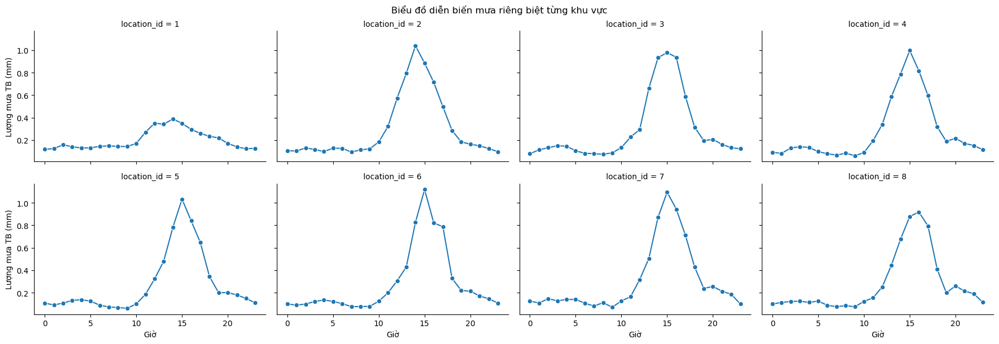

In [10]:
g = sns.relplot(
    data=climate_df, 
    x="hour", 
    y="precipitation", 
    kind="line", 
    col="location_id", 
    col_wrap=4,       # Ngắt dòng
    height=3, 
    aspect=1.5, 
    marker="o",
    estimator='mean',
    errorbar=None
)

g.fig.suptitle("Biểu đồ diễn biến mưa riêng biệt từng khu vực", y=1.02)
g.set_axis_labels("Giờ", "Lượng mưa TB (mm)")
plt.show()

Nhận xét:
- Ở tất cả khu vực, khoảng thời gian có lượng mưa lớn nhất đều tập trung vào 13-17h.
- Trong đó:
    - Khu vực 1 có lượng mưa tương nhau ở các khung giờ với khác biệt không quá lớn.
    - Các khu vực còn lại có lượng mưa khác biệt đáng kể giữa khung 13-17h so với các thời điểm khác.

**Vùng mưa di chuyển như nào trong ngày**

In [117]:
raw_data = pd.read_csv("../data/raw/hcm_weather.csv")
climate_df["latitude"] = raw_data["latitude"]
climate_df["longitude"] = raw_data["longitude"]

In [118]:
fig = px.scatter_mapbox(
    climate_df,
    lat="latitude",
    lon="longitude",
    hover_name="location_id",
    hover_data=["temperature", "precipitation"],
    zoom=10,
    size="precipitation",
    height=600,
    title="Bản đồ phân bố lượng mưa tại các trạm"
)

fig.update_layout(mapbox_style="open-street-map")
fig.show()

Dựa vào bản đồ, ta phân các tọa độ (location_id) thành 4 khu vực:
- Trung tâm: 5, 6.
- Ngoại ô: 8, 3.
- Giáp biển: 2, 1.
- Khu công nghiệp: 7, 4.

In [120]:
area_mapping = {
    5: 'Center', 6: 'Center',
    8: 'Suburb',   3: 'Suburb',
    2: 'Coastal', 1: 'Coastal',
    7: 'Industrial',    4: 'Industrial'
}
climate_df['area'] = climate_df['location_id'].map(area_mapping)

**Khác biệt về yếu tố thời tiết giữa các khu vực**

/tmp/ipykernel_162510/2108509463.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_162510/2108509463.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_162510/2108509463.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_162510/2108509463.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_162510/2108509463.py:10: FutureWarning:



Passing `palette` without assigning `hue` 

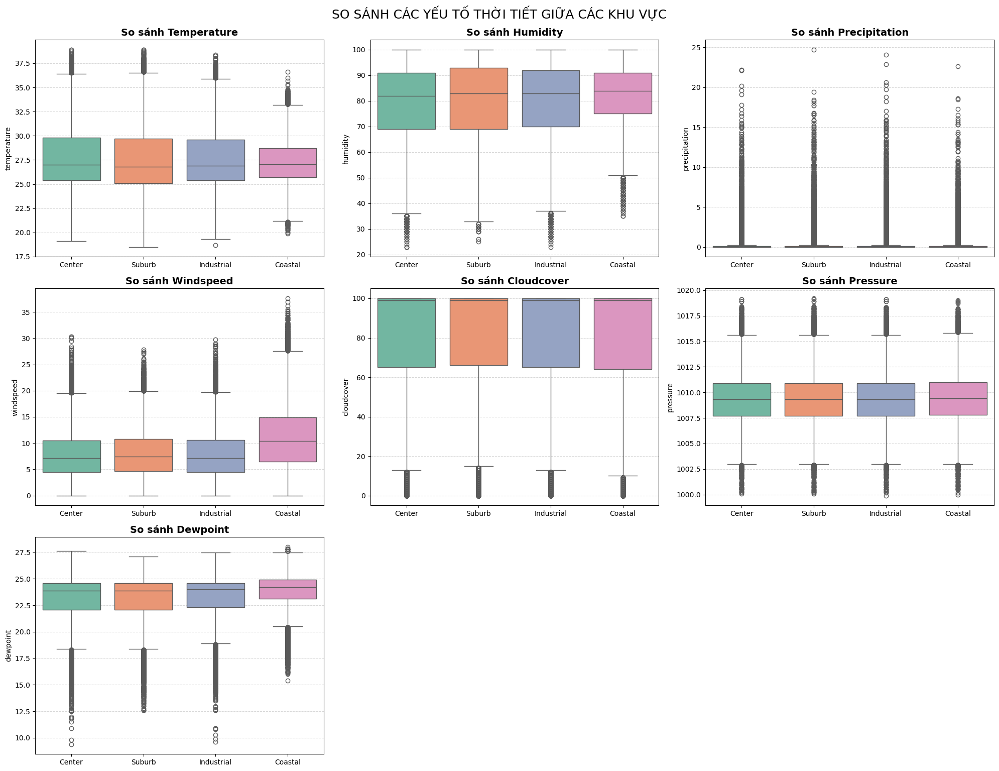

In [133]:

weather_factors = [
    'temperature', 'humidity', 'precipitation',
    'windspeed', 'cloudcover', 'pressure', 'dewpoint'
]

fig, axes = plt.subplots(3, 3, figsize=(20, 15))
axes = axes.flatten()

for i, col in enumerate(weather_factors):
    sns.boxplot(
        data=climate_df, 
        x='area',
        y=col,
        ax=axes[i],
        palette="Set2", 
        order=['Center', 'Suburb', 'Industrial', 'Coastal'] # Sắp xếp thứ tự logic đô thị hóa
    )
    
    # Trang trí
    axes[i].set_title(f"So sánh {col.capitalize()}", fontsize=14, fontweight='bold')
    axes[i].set_xlabel("")
    axes[i].grid(axis='y', linestyle='--', alpha=0.5)

# Xử lý các ô thừa (nếu lưới 3x3=9 ô mà chỉ có 7 chỉ số)
for j in range(len(weather_factors), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("SO SÁNH CÁC YẾU TỐ THỜI TIẾT GIỮA CÁC KHU VỰC", y=1.02, fontsize=18)
plt.show()

In [138]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

def deg_to_compass(num):
    val = int((num/45) + .5)
    arr = ["N", "NE", "E", "SE", "S", "SW", "W", "NW"]
    return arr[(val % 8)]

climate_df['compass_dir'] = climate_df['winddirection'].apply(deg_to_compass)

# Đếm tần suất
wind_data = climate_df.groupby(['area', 'compass_dir']).size().reset_index(name='count')

# Danh sách các hướng theo thứ tự chuẩn
compass_order = ["N", "NE", "E", "SE", "S", "SW", "W", "NW"]
# Danh sách các khu vực
areas = wind_data['area'].unique()

# Tạo lưới biểu đồ: 1 hàng, 4 cột (tương ứng 4 khu vực)
# specs=[[{'type': 'polar'}...]] là bắt buộc để khai báo đây là biểu đồ cực
fig = make_subplots(
    rows=1, cols=len(areas), 
    subplot_titles=areas, 
    specs=[[{'type': 'polar'}] * len(areas)]
)

# Vòng lặp để vẽ từng khu vực vào từng ô
for i, area in enumerate(areas):
    # Lấy dữ liệu riêng của khu vực đó
    df_area = wind_data[wind_data['area'] == area]
    
    # Reindex để đảm bảo đủ 8 hướng (kể cả hướng không có gió cũng hiện ra để biểu đồ cân đối)
    df_area = df_area.set_index('compass_dir').reindex(compass_order, fill_value=0).reset_index()
    
    # Thêm biểu đồ Barpolar vào ô tương ứng (row=1, col=i+1)
    fig.add_trace(
        go.Barpolar(
            r=df_area['count'],     # Độ dài cánh hoa
            theta=df_area['compass_dir'], # Hướng
            name=area,
            marker_color=px.colors.qualitative.Plotly[i] # Mỗi hình 1 màu cho đẹp
        ),
        row=1, col=i+1
    )

fig.update_layout(
    title_text="Biểu đồ Hoa Gió: So sánh hướng gió chủ đạo giữa các khu vực",
    template="plotly_dark",
    height=500,
    showlegend=False,
    # Cấu hình chung cho các trục cực (polar axis)
    polar=dict(radialaxis=dict(visible=True, showticklabels=False)),
    polar2=dict(radialaxis=dict(visible=True, showticklabels=False)),
    polar3=dict(radialaxis=dict(visible=True, showticklabels=False)),
    polar4=dict(radialaxis=dict(visible=True, showticklabels=False))
)

fig.show()

Nhận xét:
- Coastal (Ven biển) có khác biệt khá rõ so với phần còn lại:
    - Tốc độ gió: Biểu đồ có sự chênh lệch lớn nhất. Coastal (Median~28) cao hơn hẳn phần còn lại (~20). Đặc biệt, Coastal có rất nhiều giá trị ngoại lai (outliers) lên tới >35, chứng tỏ gió biển mạnh và thường xuyên có gió giật.
    - Nhiệt độ: Coastal có nhiệt độ trung bình thấp và dải nhiệt độ nhỏ hơn so với phần còn lại, cho thấy tính điều hòa ở biển.
    - Độ ẩm và điểm sương: Cả hai chỉ số này ở Coastal đều cao hơn. Điều này khá hiển nhiên: gần biển thì hơi nước nhiều -> độ ẩm cao -> điểm sương cao.
    
- Nét tương đồng của phần còn lại:
    - Ở hầu hết các yếu tố, cả 3 khu vực trên đất liền đều có boxplot gần giống nhau (đặc biệt là Tempurature,  Windspeed). Cho thấy rằng cả 3 khu vực đều không quá xa nhau.
    
- Về lượng mưa ở các khu vực: Biểu đồ cho thấy đặc thù của lượng mưa rằng hoặc không mưa (bẹp dí ở 0) hoặc mưa rất nhiều (nhiều outliers, nhiễu lớn). Cho thấy mưa là hiện tượng ngẫu nhiên, cục bộ, không có sự chênh lệch về lượng mưa trung bình.

- Về áp suất ở các khu vực: Biểu đồ có thể nói là giống hệt nhau ở cả 4 khu vực. Cho thấy áp suất khí quyển là yếu tố quy mô lớn, nếu đo ở cùng độ cao thì áp suất sẽ luôn tương đương nhau.

- Về độ che phủ của mây và hướng gió: 
    - Độ che phủ của mây: Median rất cao (~100%), hộp lệch hẳn lên trên.
    - Hướng gió: 
        - Trong khi 3 khu vực đất liền gần giống hệt nhau (hướng về Đông Nam, Tây Nam), Coastal lại có sự khác biệt rõ rệt (hướng đề Đông Bắc, Tây Nam). Điều này chứng minh rằng vị trí địa lý sát biển đã thay đổi hướng gió cục bộ. Có thể hướng Đông Bắc chính là hướng gió từ biển thổi vào đất liền. Đồng thời, 3 khu vực kia chịu chung một chế độ khí hậu và địa hình, không có vật cản lớn nào làm đổi hướng gió giữa chúng.
        - Ngoài ra, về 

**Khu vực nào mưa nhiều/lâu nhất**

**Lưu lượng mưa**  

<Axes: xlabel='location_id', ylabel='precipitation'>

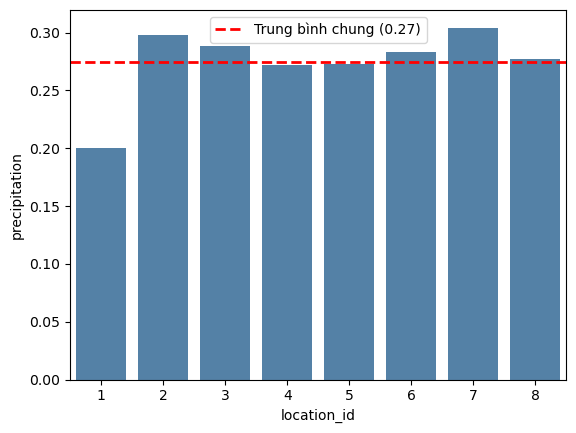

In [11]:
global_mean = climate_df['precipitation'].mean()
plt.axhline(y=global_mean, color='red', linestyle='--', linewidth=2, label=f'Trung bình chung ({global_mean:.2f})')
sns.barplot(
    data=climate_df,
    x='location_id',
    y='precipitation',
    color='#4682B4',
    errorbar=None
)

Nhận xét:
- Khu vực 2 và 7 có lượng mưa trunng bình lớn nhất (bất kể có sai số hay không).
- Khu vực 1 có lượng mưa tương đối khiêm tốn so với phần còn lại.

**Thời gian mưa**


In [12]:
rain_df = climate_df[climate_df['precipitation'] > 0].copy()
rain_df['datetime'] = pd.to_datetime(rain_df['datetime'])
time_diff = rain_df.groupby("location_id")["datetime"].diff()
rain_df['is_break'] = time_diff != pd.Timedelta('1h')
sub_group_id = rain_df.groupby('location_id')['is_break'].cumsum()
rain_df['rain_length'] = rain_df.groupby(['location_id', sub_group_id]).cumcount() + 1

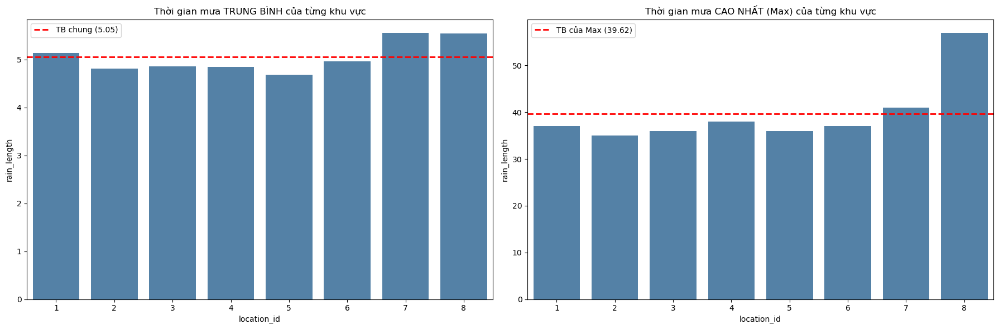

In [19]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

# BIỂU ĐỒ 1: TRUNG BÌNH
# Tính toán giá trị trung bình chung
val_mean = rain_df['rain_length'].mean()

# Vẽ barplot vào axes[0]
sns.barplot(
    data=rain_df,
    x='location_id',
    y='rain_length',
    color='#4682B4',
    errorbar=None,
    ax=axes[0]
)

# Vẽ đường line
axes[0].axhline(y=val_mean, color='red', linestyle='--', linewidth=2, label=f'TB chung ({val_mean:.2f})')
axes[0].set_title("Thời gian mưa TRUNG BÌNH của từng khu vực")
axes[0].legend() # Hiển thị chú thích cho đường đỏ


# BIỂU ĐỒ 2: CAO NHẤT 
val_max_mean = rain_df.groupby("location_id")["rain_length"].max().mean()

sns.barplot(
    data=rain_df,
    x='location_id',
    y='rain_length',
    estimator=np.max,
    color='#4682B4',
    errorbar=None,
    ax=axes[1]
)

# Vẽ đường line vào axes[1]
axes[1].axhline(y=val_max_mean, color='red', linestyle='--', linewidth=2, label=f'TB của Max ({val_max_mean:.2f})')
axes[1].set_title("Thời gian mưa CAO NHẤT (Max) của từng khu vực")
axes[1].legend()

# Tự động căn chỉnh khoảng cách giữa 2 biểu đồ cho không bị dính chữ
plt.tight_layout()
plt.show()

Nhận xét:
- Độ dài những cơn mưa ở mỗi khu vực không khác biệt nhau quá rõ rệt. Tuy nhiên, vẫn có thể chỉ ra rằng khu vực 7 và 8 có độ dài trung bình những cơn mưa cao nhất.
- Với độ dài tối đa, khu vực 8 lại chỉ ra sự khác biệt rõ rệt với độ dài là 57 giờ.

In [99]:
import plotly.express as px

fig = px.scatter_mapbox(
    climate_df,
    lat="latitude",
    lon="longitude",
    hover_name="location_id",
    hover_data=["temperature", "precipitation"],
    color="location_id",
    zoom=10,
    size="precipitation",
    height=600,
    title="Bản đồ phân bố lượng mưa tại các trạm"
)

fig.update_layout(mapbox_style="open-street-map")
fig.show()